<div style="background-color: brown; padding: 10px;">

Course [IT790A] Explainable AI

Name: Abed Bakkour

Username: a22abeal
</div>

## Contents

- [Setup](#Setup-and-overview)

- [Data cleaning](#Data-cleaning)

    - [Categorical variables](#Categorical-variables)

    - [Numerical variables](#Numerical-variables)

- [Grid search and modeling](#Grid-search-and-modeling)

- [Train](#Train-with-best-parameters)

- [Predict](#Predict)

- [Explain model with LIME](#Explain-model-with-LIME)

- [Local explanation](#LIME-Local-explanation-(one-day))

In [1]:
import pandas as pd
import numpy as np
np.random.seed(0)
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as px

from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn import preprocessing
from sklearn.model_selection import train_test_split, GridSearchCV
import xgboost as xgb

np.random.seed(0)

import lime
import shap
from lime.lime_tabular import LimeTabularExplainer
import time

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Setup and overview 

[For detailed information](https://archive.ics.uci.edu/ml/datasets/bike+sharing+dataset)

In [2]:
df = pd.read_csv('../data/day-bikesharing.csv',parse_dates=['dteday'],index_col=1) # Load the data

In [3]:
df.shape

(731, 15)

In [4]:
def add_features(df):
    df['year'] = df.index.year # yr exists already
    df['month'] = df.index.month
    df['day'] = df.index.day
    df['dayofweek'] = df.index.dayofweek

2011.Jan.1 is a Saturday.

In [5]:
add_features(df)
df.head(3)

,instant,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,year,month,day,dayofweek
dteday,,,,,,,,,,,,,,,,,,,
2011-01-01,1,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.160446,331,654,985,2011,1,1,5
2011-01-02,2,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.248539,131,670,801,2011,1,2,6
2011-01-03,3,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.248309,120,1229,1349,2011,1,3,0


## Notice: We select meaningful variables for a better understanding of the SHAP results. 

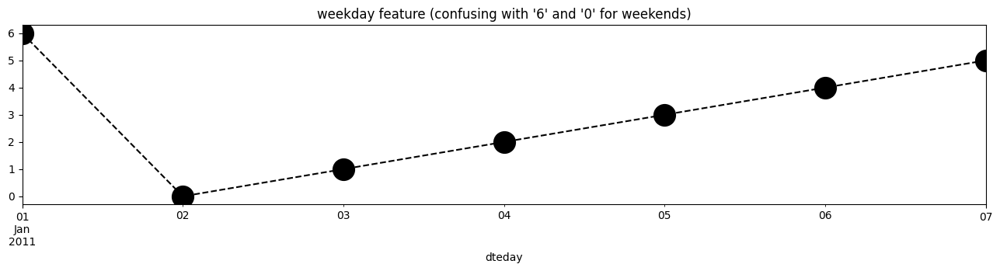

In [6]:
# Let's use 'dayofweek' instead of 'weekday'.
plt.figure(figsize=(16,3))
df['weekday'][:7].plot(linestyle='--', marker='o', color='k', ms=20, 
                       title='weekday feature (confusing with \'6\' and \'0\' for weekends)')
plt.show()

## We will use 'dayofweek' variable when describing each day of a week. Weekends of Saturday and Sunday are 5 and 6. The other weekdays are 0 to 4.

- When analyzing with SHAP, we consider higher numbers of 'dayofweek' feature to show the weekends.

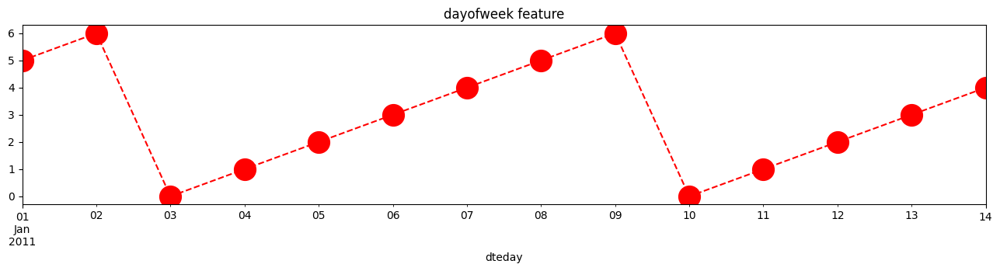

In [7]:
plt.figure(figsize=(16,3))
df['dayofweek'][:14].plot(linestyle='--', marker='o', color='r', ms=20, 
                       title='dayofweek feature')
plt.show()

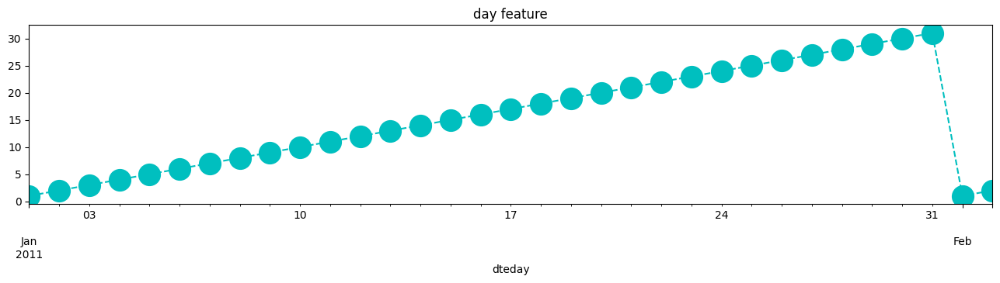

In [8]:
# Day feature shows whether it is a start of the month or the end of the month (1 to 30 or 31).
plt.figure(figsize=(16,3))
df['day'][:33].plot(linestyle='--', marker='o', color='c', ms=20, title='day feature')
plt.show()

## Workingday feature is a boolean. 

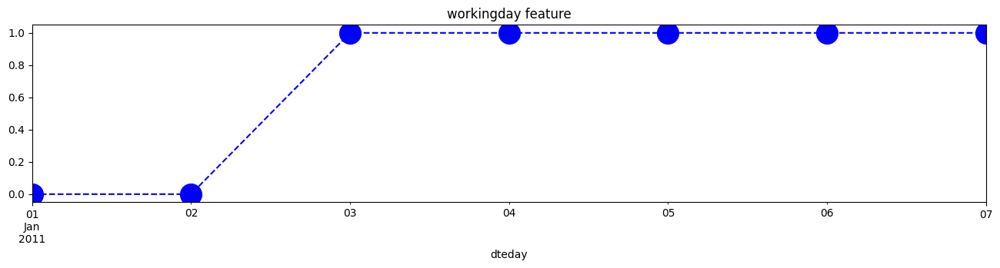

In [9]:
plt.figure(figsize=(16,3))
df['workingday'][:7].plot(linestyle='--', marker='o', color='b', ms=20, title='workingday feature')
plt.show()

## Note that season 1 indicates winter.

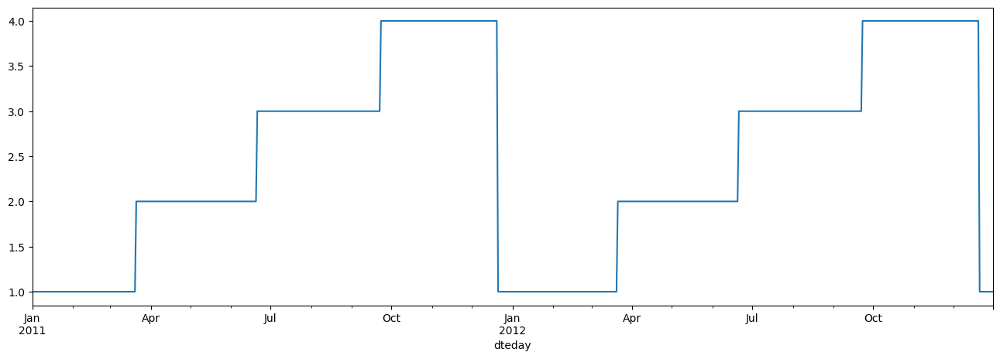

In [10]:
plt.figure(figsize=(16,5))
df['season'].plot()
plt.show()

In [11]:
df.season.value_counts()

3    188
2    184
1    181
4    178
Name: season, dtype: int64

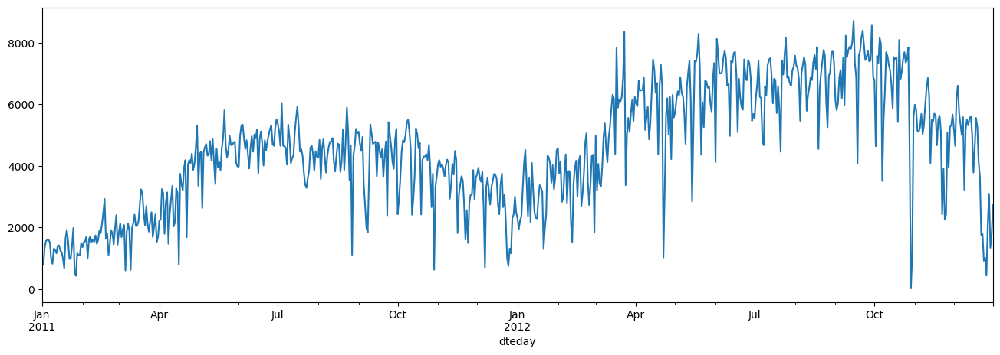

In [12]:
plt.figure(figsize=(16,5))
df['cnt'].plot()
plt.show()

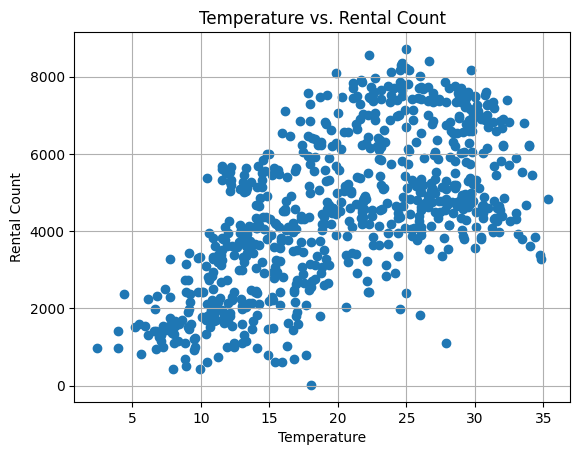

In [13]:
plt.scatter(x=df.temp*41,y=df["cnt"]) # denormalize temperature by multiplying 41
plt.grid(True)
plt.xlabel('Temperature')
plt.ylabel('Rental Count')
plt.title('Temperature vs. Rental Count')
plt.show()

Text(0.5, 1.0, 'Average Rental Count by Month')

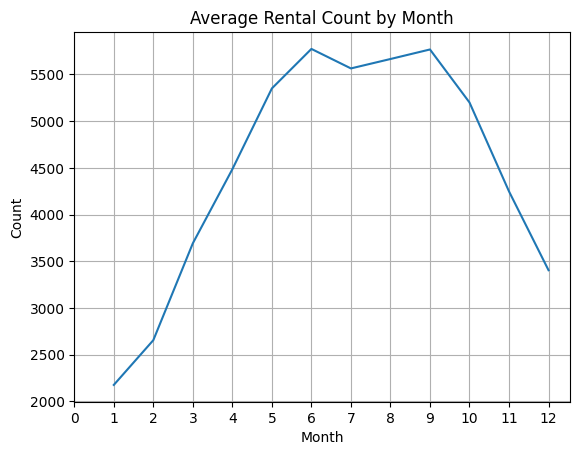

In [14]:
# from January to April, the demand is relatively low due to Winter 
#(there are not a lot of people that's brave enough to bike on icy road, are there?). 
# And the peak demand happends around Summer time (from May to October) and drop again.
group_month = df.groupby(['month'])
average_by_month = group_month['cnt'].mean()

plt.plot(average_by_month.index,average_by_month)
plt.xlabel('Month')
plt.ylabel('Count')
plt.xticks(np.arange(13))
plt.grid(True)
plt.title('Average Rental Count by Month')

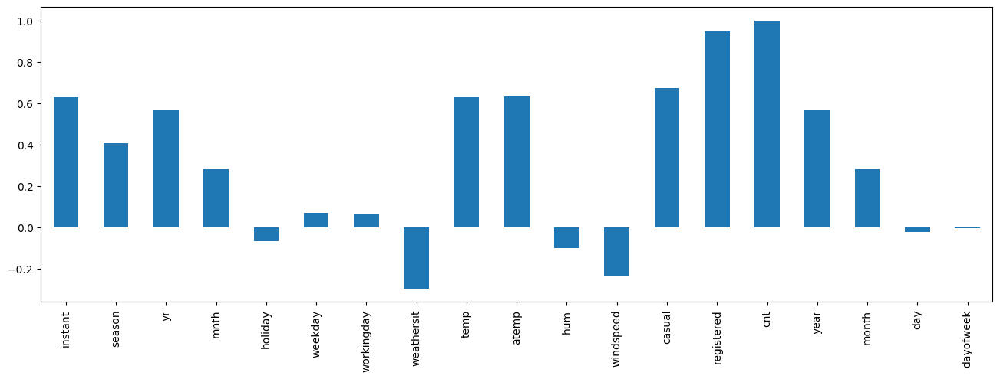

In [15]:
#correlation of total cnt with other variables
plt.figure(figsize=(16,5))
df.corr()['cnt'].plot(kind='bar')
plt.show()

In [16]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
instant,731.0,366.000000,211.165812,1.000000,183.500000,366.000000,548.500000,731.000000
season,731.0,2.496580,1.110807,1.000000,2.000000,3.000000,3.000000,4.000000
yr,731.0,0.500684,0.500342,0.000000,0.000000,1.000000,1.000000,1.000000
mnth,731.0,6.519836,3.451913,1.000000,4.000000,7.000000,10.000000,12.000000
holiday,731.0,0.028728,0.167155,0.000000,0.000000,0.000000,0.000000,1.000000
weekday,731.0,2.997264,2.004787,0.000000,1.000000,3.000000,5.000000,6.000000
workingday,731.0,0.683995,0.465233,0.000000,0.000000,1.000000,1.000000,1.000000
weathersit,731.0,1.395349,0.544894,1.000000,1.000000,1.000000,2.000000,3.000000
temp,731.0,0.495385,0.183051,0.059130,0.337083,0.498333,0.655417,0.861667
atemp,731.0,0.474354,0.162961,0.079070,0.337842,0.486733,0.608602,0.840896


In [17]:
df.dtypes

instant         int64
season          int64
yr              int64
mnth            int64
holiday         int64
weekday         int64
workingday      int64
weathersit      int64
temp          float64
atemp         float64
hum           float64
windspeed     float64
casual          int64
registered      int64
cnt             int64
year            int64
month           int64
day             int64
dayofweek       int64
dtype: object

# Data cleaning

# Categorical variables

Perform one hot encoding on categorical variables. Machine learning algorithms assume (and require) the data to be numeric, so the categorical data must be pre-processed as a numerical data.  Categorical variables turn into binary features that are 'one hot' encoded, so if a feature is represented by that column, it receives a 1, otherwise a 0.

- The 'season' feature has 1: winter, 2: spring, 3: summer, 4: fall. 
- The 'holiday' and 'workingday' features are boolean: 1 when it is a holiday. 1 when it is a working day.

In [18]:
# Define the categorical variables
cat_var = ['season', 'holiday', 'workingday', 'weathersit', 'year']

In [19]:
# OneHotEncoder
ohe = OneHotEncoder(categories = 'auto')

In [20]:
# Fit the categorical variables to the encoder
encodeddf = ohe.fit_transform(df[cat_var])

In [21]:
# Create a DataFrame with the encoded value information
cat_df = pd.DataFrame(data = encodeddf.toarray(), columns = ohe.get_feature_names_out(cat_var))
cat_df

,season_1,season_2,season_3,season_4,holiday_0,holiday_1,workingday_0,workingday_1,weathersit_1,weathersit_2,weathersit_3,year_2011,year_2012
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0


In [22]:
# rename the column names from 1,2,3,4 to spring, summer, fall, winter
cat_df.rename(columns={'season_1': 'winter', 'season_2': 'spring', 'season_3': 'summer', 'season_4': 'fall'}, inplace=True)
cat_df.rename(columns={'weathersit_1': 'clear', 'weathersit_2': 'cloudy', 'weathersit_3': 'lightsnow.rain'}, inplace=True)
cat_df

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0


# Numerical variables

Machine learning is sensitive to the relative scales of numerical variables. The range of all variables need to be normalized so that each feature contributes approximately proportionately to the calculation.

In [23]:
# Define the numerical variables
num_var = ['temp', 'atemp', 'hum', 'windspeed', 'month', 'day', 'dayofweek']       

Create standardized, normalized

In [24]:
# StandardScaler object
scaler = StandardScaler()

In [25]:
# Fit the data to the scaler
numscaled = scaler.fit_transform(df[num_var])

Keep the original for later view

In [26]:
# for inverse transformation
inversed = scaler.inverse_transform(numscaled)
print(inversed)

[[ 0.344167  0.363625  0.805833 ...  1.        1.        5.      ]
 [ 0.363478  0.353739  0.696087 ...  1.        2.        6.      ]
 [ 0.196364  0.189405  0.437273 ...  1.        3.        0.      ]
 ...
 [ 0.253333  0.2424    0.752917 ... 12.       29.        5.      ]
 [ 0.255833  0.2317    0.483333 ... 12.       30.        6.      ]
 [ 0.215833  0.223487  0.5775   ... 12.       31.        0.      ]]


In [27]:
# Create DataFrame with original data
inversed_df = pd.DataFrame(data = inversed, columns = num_var)
inversed_df

# Calculate based on UCI info to retrieve the actual temperature and weather information
#temp : Normalized temperature in Celsius. The values are divided to 41 (max)
#atemp: Normalized feeling temperature in Celsius. The values are divided to 50 (max)
#hum: Normalized humidity. The values are divided to 100 (max)
#windspeed: Normalized wind speed. The values are divided to 67 (max)
inversed_origin = pd.concat([inversed_df.iloc[:,0] * 41, #temperature
           inversed_df.iloc[:,1] * 50,                   #feeling temperature
           inversed_df.iloc[:,2] * 100,                  #humidity
           inversed_df.iloc[:,3] * 67],                  #wind speed
          axis=1)
inversed_origin

,temp,atemp,hum,windspeed
0,14.110847,18.18125,80.5833,10.749882
1,14.902598,17.68695,69.6087,16.652113
2,8.050924,9.47025,43.7273,16.636703
3,8.200000,10.60610,59.0435,10.739832
4,9.305237,11.46350,43.6957,12.522300
...,...,...,...,...
726,10.420847,11.33210,65.2917,23.458911
727,10.386653,12.75230,59.0000,10.416557
728,10.386653,12.12000,75.2917,8.333661
729,10.489153,11.58500,48.3333,23.500518


<AxesSubplot: >

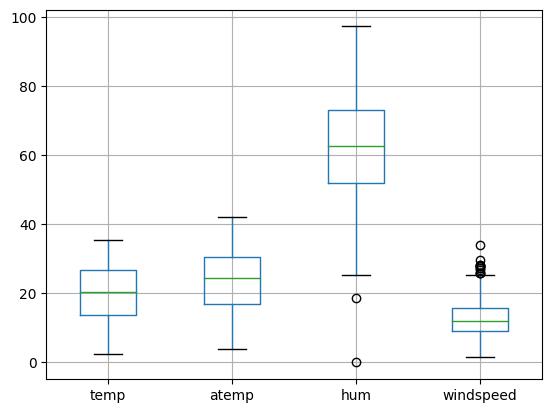

In [28]:
# Units are different but still can review the distribution
inversed_origin.boxplot()

Text(0.5, 0, 'daily time (# rows)')

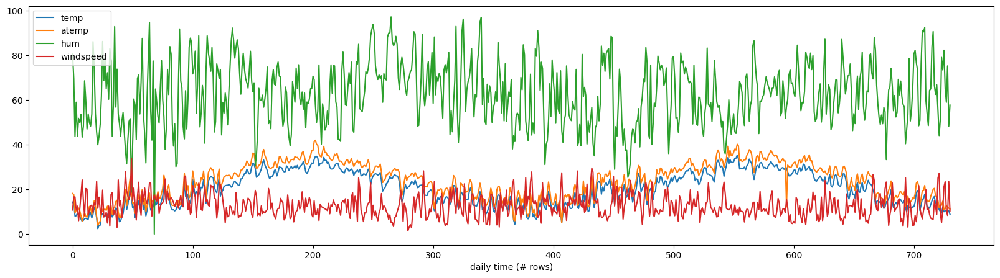

In [29]:
# Time series of the four features
ax = inversed_origin.set_index(inversed_origin.index).plot(figsize=(20,5))
ax.set_xlabel('daily time (# rows)')

In [30]:
X_original = pd.concat([cat_df, inversed_origin, inversed_df[['month', 'day', 'dayofweek']]], axis=1)
X_original # Use this for SHAP plot view

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.110847,18.18125,80.5833,10.749882,1.0,1.0,5.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.902598,17.68695,69.6087,16.652113,1.0,2.0,6.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.050924,9.47025,43.7273,16.636703,1.0,3.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.200000,10.60610,59.0435,10.739832,1.0,4.0,1.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,9.305237,11.46350,43.6957,12.522300,1.0,5.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,10.420847,11.33210,65.2917,23.458911,12.0,27.0,3.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,10.386653,12.75230,59.0000,10.416557,12.0,28.0,4.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,10.386653,12.12000,75.2917,8.333661,12.0,29.0,5.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,10.489153,11.58500,48.3333,23.500518,12.0,30.0,6.0


In [31]:
# Create DataFrame with numerically scaled data
num_df = pd.DataFrame(data = numscaled, columns = num_var)
num_df

,temp,atemp,hum,windspeed,month,day,dayofweek
0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930
1,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077
2,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809
3,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661
4,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513
...,...,...,...,...,...,...,...
726,-1.318665,-1.521108,0.175807,2.061426,1.588660,1.279122,-0.001366
727,-1.323224,-1.346690,-0.266238,-0.452131,1.588660,1.392707,0.497782
728,-1.323224,-1.424344,0.878392,-0.853552,1.588660,1.506293,0.996930
729,-1.309558,-1.490049,-1.015664,2.069444,1.588660,1.619879,1.496077


Define X (input): Concatenate one hot encoded categorical + normalized numerical data

In [32]:
# Xdf: normalized
Xdf = pd.concat([cat_df, num_df], axis = 1)
Xdf.head(5)

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513


In [33]:
# Save column names for SHAP usage
NAMES = Xdf.columns
NAMES

Index(['winter', 'spring', 'summer', 'fall', 'holiday_0', 'holiday_1',
       'workingday_0', 'workingday_1', 'clear', 'cloudy', 'lightsnow.rain',
       'year_2011', 'year_2012', 'temp', 'atemp', 'hum', 'windspeed', 'month',
       'day', 'dayofweek'],
      dtype='object')

<AxesSubplot: >

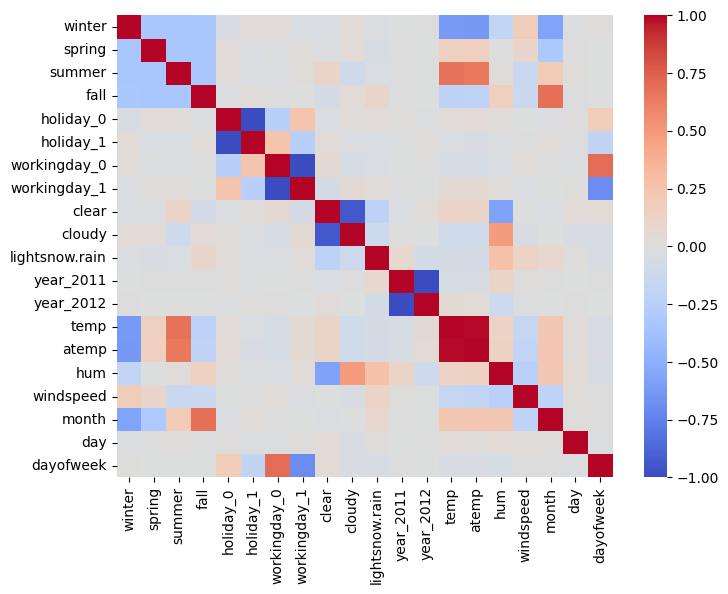

In [34]:
plt.subplots(figsize=(8, 6))
sb.heatmap(Xdf.corr(), cmap='coolwarm')

In [35]:
# Check if there is any non available
Xdf.isna().any().sum()

0

Define Y (to predict): Extract target

In [36]:
# Here, indicate which target to predict (cnt or casual or registered) 
to_predict = 'cnt'

In [37]:
# Here, indicate which target to predict (cnt or casual or registered) 
y = df[to_predict]

# Normalize target data: Calculate mean and standard deviation
y_mu = y.mean(0)
y_sd = y.std(0)

print('y mean:', y_mu, ' y std:' , y_sd)

y_norm = (y - y_mu) / y_sd
y_norm = y_norm.values.ravel() #dataframe to 1D array
#y_norm

y mean: 4504.3488372093025  y std: 1937.2114516187676


Split training and test data

In [38]:
np.random.seed(1234)
# Split the data into training, validation, and test data:
X_train, X_test, y_train, y_test = train_test_split(Xdf, y_norm, test_size = 0.2, random_state=1)
# Validation set
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=1) 

# Grid search and modeling

In [39]:
# A parameter grid for XGBoost
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5]
        }

In [40]:
# Build the model with 
# XGBoost Training Parameter Reference: 
#   https://github.com/dmlc/xgboost
#   https://xgboost.readthedocs.io/en/latest/parameter.html

# XGBRegressor object and GridSearch object
xgbmodel = xgb.XGBRegressor() 
clf = GridSearchCV(estimator = xgbmodel,
                   param_grid = params,
                   cv = 3,
                   verbose=1)

In [41]:
# Fit the training data to the GridSearch object
t0 = time.time()
clf.fit(X_train, y_train)
t1 = time.time()
print(t1-t0, " sec taken")

Fitting 3 folds for each of 405 candidates, totalling 1215 fits
66.28478646278381  sec taken


In [42]:
# Display the best parameters from the GridSearch
print(clf.best_params_)
print(clf.best_score_)

{'colsample_bytree': 0.8, 'gamma': 0.5, 'max_depth': 4, 'min_child_weight': 5, 'subsample': 0.8}
0.8633448414950647


# Train with best parameters

In [43]:
from sklearn._config import get_config, set_config
set_config(print_changed_only=False)

In [44]:
xgbmodel = xgb.XGBRegressor(**clf.best_params_, random_state=0)

In [45]:
# Fit the training data to the model
xgbmodel.fit(X_train, y_train, eval_set = [(X_train, y_train), (X_val, y_val)])

[0]	validation_0-rmse:0.84811	validation_1-rmse:0.86342
[1]	validation_0-rmse:0.67246	validation_1-rmse:0.69370
[2]	validation_0-rmse:0.54534	validation_1-rmse:0.58267
[3]	validation_0-rmse:0.45971	validation_1-rmse:0.50922
[4]	validation_0-rmse:0.40182	validation_1-rmse:0.45342
[5]	validation_0-rmse:0.36729	validation_1-rmse:0.40947
[6]	validation_0-rmse:0.33601	validation_1-rmse:0.38506
[7]	validation_0-rmse:0.31756	validation_1-rmse:0.37200
[8]	validation_0-rmse:0.30014	validation_1-rmse:0.36170
[9]	validation_0-rmse:0.28967	validation_1-rmse:0.35561
[10]	validation_0-rmse:0.28115	validation_1-rmse:0.34970
[11]	validation_0-rmse:0.27210	validation_1-rmse:0.34349
[12]	validation_0-rmse:0.27027	validation_1-rmse:0.33654
[13]	validation_0-rmse:0.26416	validation_1-rmse:0.33288
[14]	validation_0-rmse:0.25919	validation_1-rmse:0.33080
[15]	validation_0-rmse:0.25919	validation_1-rmse:0.33081
[16]	validation_0-rmse:0.25706	validation_1-rmse:0.32948
[17]	validation_0-rmse:0.25709	validation

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.5, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=5, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             objective='reg:squarederror', predictor=None, ...)

# Predict

In [46]:
eval_result = xgbmodel.evals_result()
training_rounds = range(len(eval_result['validation_0']['rmse'])) #training
print(training_rounds)

range(0, 100)


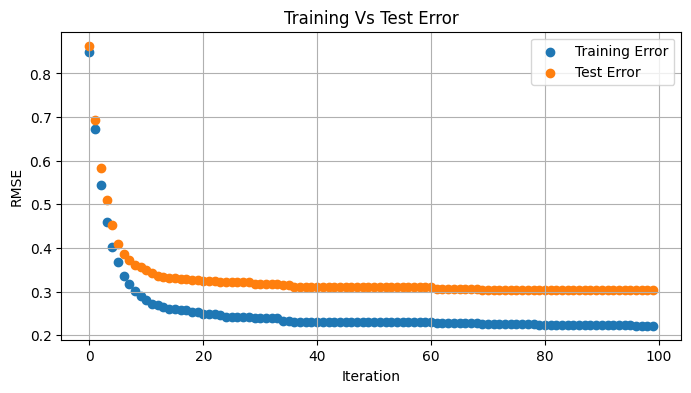

In [47]:
plt.figure(figsize=(8,4))
plt.scatter(x=training_rounds,y=eval_result['validation_0']['rmse'],label='Training Error')
plt.scatter(x=training_rounds,y=eval_result['validation_1']['rmse'],label='Test Error')
plt.grid(True)
plt.xlabel('Iteration')
plt.ylabel('RMSE')
plt.title('Training Vs Test Error')
plt.legend()
plt.show()

In [48]:
ypredicted = xgbmodel.predict(X_test) 

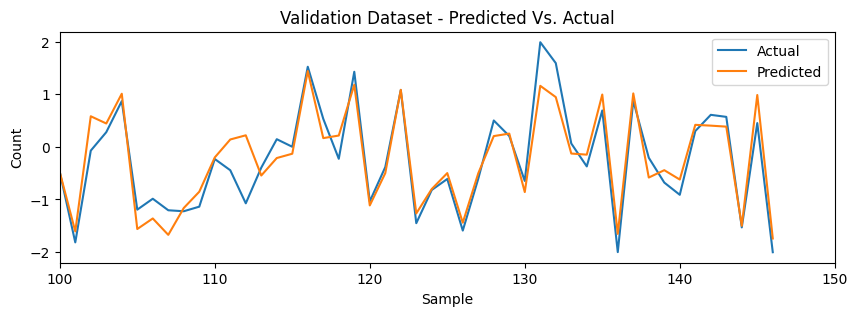

In [49]:
plt.figure(figsize=(10,3))
# Actual Vs Predicted
plt.plot(y_test, label='Actual')
plt.plot(ypredicted, label='Predicted')
plt.xlabel('Sample')
plt.ylabel('Count')
plt.xlim([100,150])
plt.title('Validation Dataset - Predicted Vs. Actual')
plt.legend()
plt.show()

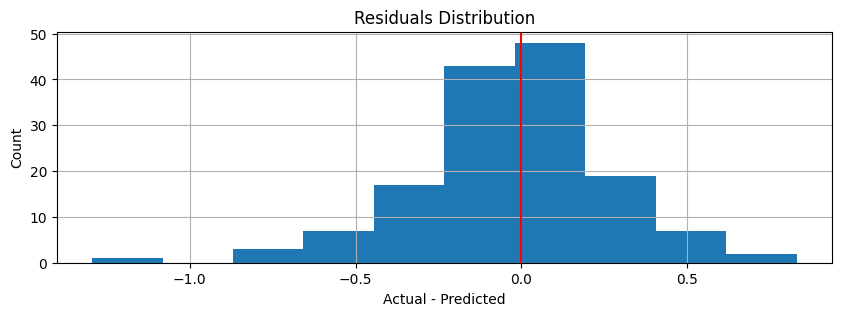

In [50]:
# Over prediction and Under Prediction needs to be balanced
# Training Data Residuals
residuals = (y_test - ypredicted) # * y_sd + y_mu (for actual cnt numbers)

plt.figure(figsize=(10,3))
plt.hist(residuals)
plt.grid(True)
plt.xlabel('Actual - Predicted')
plt.ylabel('Count')
plt.title('Residuals Distribution')
plt.axvline(color='r')
plt.show()

In [51]:
print("RMSE: {0:0.4f}".format(mean_squared_error(y_test, ypredicted)))

RMSE: 0.0884


In [52]:
# Show the influencing features in order (with feature_importances_)
# Indicate which parameter used to decide the ranking of important features
important_features = pd.Series(data=xgbmodel.feature_importances_, index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

# There are different parameters:
# Refer to, https://github.com/dmlc/xgboost/blob/master/python-package/xgboost/core.py
#        * 'weight': the number of times a feature is used to split the data across all trees.
#        * 'gain': the average gain across all splits the feature is used in.
#        * 'cover': the average coverage across all splits the feature is used in.
#        * 'total_gain': the total gain across all splits the feature is used in.
#        * 'total_cover': the total coverage across all splits the feature is used in.

year_2012         0.334441
month             0.148238
year_2011         0.093973
atemp             0.091646
winter            0.060549
fall              0.057606
clear             0.034687
cloudy            0.033488
temp              0.031691
lightsnow.rain    0.028922
hum               0.022926
windspeed         0.017095
workingday_0      0.010901
holiday_0         0.009047
day               0.007691
dayofweek         0.007369
workingday_1      0.007166
spring            0.002563
holiday_1         0.000000
summer            0.000000
dtype: float32


In [53]:
important_features = pd.Series(data=xgbmodel.get_booster().get_score(importance_type='gain'), index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

year_2012         24.965616
month             11.065815
year_2011          7.015013
atemp              6.841238
winter             4.519948
fall               4.300218
clear              2.589336
cloudy             2.499859
temp               2.365730
lightsnow.rain     2.159016
hum                1.711424
windspeed          1.276122
workingday_0       0.813745
holiday_0          0.675331
day                0.574106
dayofweek          0.550102
workingday_1       0.534939
spring             0.191319
summer                  NaN
holiday_1               NaN
dtype: float64


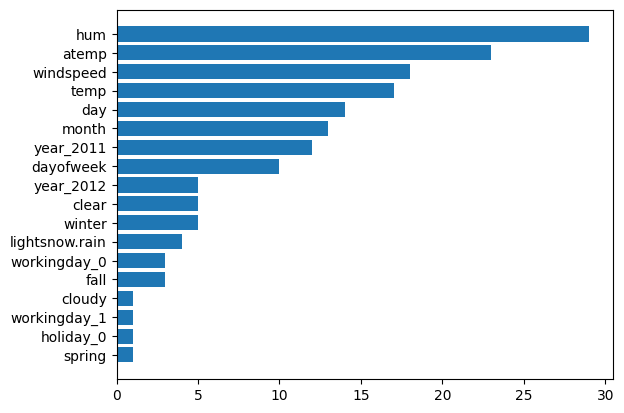

In [54]:
# Show the influencing features in order (with get_booster().get_fscore())
# fscore is based on the number of times a feature is used in a tree
fscore = xgbmodel.get_booster().get_fscore().items()
lists = sorted(fscore, key=lambda x:x[1]) # sorted by value, return a list of tuples
fkey, fvalue = zip(*lists) # unpack a list of pairs into two tuples

plt.barh(fkey, fvalue)
plt.show()

# Check which single instance to compare with SHAP

In [55]:
# Select from the test set
# when atemp Low/hum Higher[301]:cnt627  
test = X_test[ (X_test['atemp'] < -1) & (X_test['hum'] > 1)]
print(test.shape)
test.head(5)

(2, 20)


,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
35,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-1.432558,-1.420304,2.116697,-0.379718,-1.310268,-1.219765,0.99693
301,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,-1.318665,-1.513304,1.788822,2.077411,1.008875,1.506293,0.99693


In [56]:
PICK = 301 #atempLow/humHigher[301]:cnt627      
Xdf[Xdf.index==PICK]

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
301,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,-1.318665,-1.513304,1.788822,2.077411,1.008875,1.506293,0.99693


In [57]:
# review the target values, y[301] has target cnt = 627 which is a very low bike rental count
print("target count is:", y[301])

target count is: 627


In [58]:
# For comparison, keep the indices that were used for SHAP cases
SAMPLE1 = 364 #winter, weekend day (from test)
SAMPLE2 = 180 #summer, working day (from test)

# Select one day for investigation with a force plot later
weekEnd_sample = Xdf.loc[[SAMPLE1]]   #winter, weekend day (from test)
weekDay_sample = Xdf.loc[[SAMPLE2]]   #summer, working day (from test)

weekEnd_sample_origin = X_original.loc[[SAMPLE1]]
weekDay_sample_origin = X_original.loc[[SAMPLE2]]
weekEnd_sample 

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
364,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,-0.466773,-0.369869,-0.084739,0.383083,1.58866,1.733465,0.99693


# Explain model with LIME

In [59]:
X_original.head(5)

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.110847,18.18125,80.5833,10.749882,1.0,1.0,5.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.902598,17.68695,69.6087,16.652113,1.0,2.0,6.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.050924,9.47025,43.7273,16.636703,1.0,3.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.200000,10.60610,59.0435,10.739832,1.0,4.0,1.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,9.305237,11.46350,43.6957,12.522300,1.0,5.0,2.0


In [60]:
# let the LIME Explainer know which features are categorical
categorical_features = [0,1,2,3,4,5,6,7,8,9,10,11,12]

In [61]:
categorical_names = {}
for feature in categorical_features:    
    le = LabelEncoder()
    le.fit(Xdf.iloc[:, feature])
    categorical_names[feature] = le.classes_

In [62]:
# Initialize the explainer
# Note that this is a regression problem, not a classification
explainer = LimeTabularExplainer(X_train.values, feature_names=NAMES,
                                  categorical_features=categorical_features, 
                                  categorical_names=categorical_names,
                                  verbose=True, mode='regression')

# LIME Local explanation (one day)

In [63]:
print("winter, weekend day target count:", y[SAMPLE1])
print("summer, working day target count:", y[SAMPLE2])

winter, weekend day target count: 2485
summer, working day target count: 5515


,cnt
count,731.000000
mean,4504.348837
std,1937.211452
min,22.000000
25%,3152.000000
50%,4548.000000
75%,5956.000000
max,8714.000000


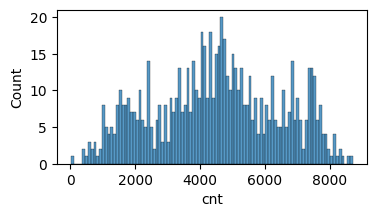

In [64]:
plt.figure(figsize=(4,2))
ax = sb.histplot(data=df, x="cnt", bins=100)
pd.DataFrame((df['cnt']).describe())

# Explain this one day: Weekend, Winter

In [65]:
weekEnd_sample_origin

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
364,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,16.81,20.70605,61.5833,14.750318,12.0,31.0,5.0


In [66]:
# Explain one day: Weekend
# winter, weekend day target count: 2485
print("WEEKEND in Winter")
#Explanation object has information about features contributions to this particular prediction
exp_WE = explainer.explain_instance(weekEnd_sample.values[0], xgbmodel.predict, num_features=10)
exp_WE.show_in_notebook(show_all=False)

WEEKEND in Winter
Intercept -0.13717358059366633
Prediction_local [-0.57309594]
Right: -0.6958025


# Explanation
Based on the local model, the prediction value showed -0.597 while the actual model predicted -0.696, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected by the year 2011 feature. Being winter and having a lower feeling temperature affect the rent prediction negatively.

Having no light snow or rain, low humidity, and clear skies raise the rent prediction, but not enough to push the scales toward positive.


In [67]:
# Explain one day: Weekend
# winter, weekend day target count: 2485
print("WEEKEND in Winter (restrict to 5 features)")
#Explanation object has information about features contributions to this particular prediction
exp_WE = explainer.explain_instance(weekEnd_sample.values[0], xgbmodel.predict, num_features=5)
exp_WE.show_in_notebook(show_all=False) 

WEEKEND in Winter (restrict to 5 features)
Intercept 0.26500944484935046
Prediction_local [-0.52061615]
Right: -0.6958025


In [68]:
# Feature-Contribution mapping
pd.DataFrame(exp_WE.as_list(),columns=['Feature','Contribution'])

,Feature,Contribution
0,year_2011=1.0,-0.520235
1,year_2012=0.0,-0.421981
2,winter=1.0,-0.212996
3,-0.73 < hum <= 0.04,0.195789
4,clear=1.0,0.173798


In [69]:
# same with LIME plot
#with plt.style.context("ggplot"):
#    exp_WE.as_pyplot_figure()

# Explain this one day: Weekday, Summer

In [70]:
# Change input to another day for local explanation: Weekday
#Explanation object has information about features contributions to this particular prediction
# summer, working day target count: 5515
print("WEEKDAY in Summer")
exp_wd = explainer.explain_instance(weekDay_sample.values[0], xgbmodel.predict, num_features=25)
exp_wd.show_in_notebook(show_all=False) 

WEEKDAY in Summer
Intercept -0.34924014881796034
Prediction_local [0.09830227]
Right: 0.22199456


In [71]:
# Note that the LIME prediction has changed with 5 features input in this case
# summer, working day target count: 5515
print("WEEKDAY in Summer (restrict to 5 features)")
exp_wd = explainer.explain_instance(weekDay_sample.values[0], xgbmodel.predict, num_features=5)
exp_wd.show_in_notebook(show_all=False) 

WEEKDAY in Summer (restrict to 5 features)
Intercept 0.16906834849247088
Prediction_local [-0.20076617]
Right: 0.22199456


In [72]:
pd.DataFrame(exp_wd.as_list(),columns=['Feature','Contribution'])

,Feature,Contribution
0,year_2011=1.0,-0.524257
1,year_2012=0.0,-0.435940
2,hum <= -0.73,0.214068
3,atemp > 0.82,0.191429
4,clear=1.0,0.184865


In [73]:
# how to get LIME Prediction value
exp_wd.intercept[1] + pd.DataFrame(exp_wd.as_list())[1].sum()

-0.20076616629950328

# Explore the relationship between atemp and humidity (compare w SHAP)

In [74]:
# Select one day for investigation
aL_hH = Xdf.loc[[301]] #atempLow/humHigher[301]:cnt627      
aL_hL = Xdf.loc[[368]] #atempLow/humLower[368]:cnt2368      
aH_hL = Xdf.loc[[551]] #atempHigh/humLower[551]:cnt6241      
aH_hA = Xdf.loc[[584]] #atempHigh/humAvg[584]:cnt7273      

aL_hH_origin = X_original.loc[[301]]
aL_hL_origin = X_original.loc[[368]]
aH_hL_origin = X_original.loc[[551]]
aH_hA_origin = X_original.loc[[584]]
aH_hA_origin

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
584,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,30.169153,34.88105,70.375,7.832836,8.0,7.0,1.0


In [75]:
#1 [301]
print("atemp Lower/ hum Higher")
exp_aL_hH = explainer.explain_instance(aL_hH.values[0], xgbmodel.predict, num_features=5)
exp_aL_hH.show_in_notebook(show_all=False) 
#2 [368]
print("atemp Lower/ hum Lower")
exp_aL_hL = explainer.explain_instance(aL_hL.values[0], xgbmodel.predict, num_features=5)
exp_aL_hL.show_in_notebook(show_all=False) 
#3 [551]
print("atemp Higher/ hum Lower")
exp_aH_hL = explainer.explain_instance(aH_hL.values[0], xgbmodel.predict, num_features=5)
exp_aH_hL.show_in_notebook(show_all=False) 
#4 [584]
print("atemp Higher/ hum Average")
exp_aH_hA = explainer.explain_instance(aH_hA.values[0], xgbmodel.predict, num_features=5)
exp_aH_hA.show_in_notebook(show_all=False) 


atemp Lower/ hum Higher
Intercept 0.6834259351334523
Prediction_local [-1.49897929]
Right: -1.6550077


atemp Lower/ hum Lower
Intercept -0.26916617732582204
Prediction_local [-0.46064575]
Right: -0.8665453


atemp Higher/ hum Lower
Intercept -0.8553477926513701
Prediction_local [0.81260366]
Right: 0.89202654


atemp Higher/ hum Average
Intercept -0.8617095307885088
Prediction_local [0.79119369]
Right: 1.1825035


# Check the distribution

In [76]:
# normalized vs original: distribution of humidity, normalized value and ignore scientific format
df_hat_n = pd.DataFrame(Xdf['hum'].describe().apply(lambda x: format(x, 'f')))
df_hat_n['atemp'] = Xdf['atemp'].describe().apply(lambda x: format(x, 'f'))
df_hat_n['temp'] = Xdf['temp'].describe().apply(lambda x: format(x, 'f'))

df_hat = pd.DataFrame((df['hum']*100).describe())
df_hat['atemp'] = ((df['atemp']*50).describe())
df_hat['temp'] = ((df['temp']*41).describe())

In [77]:
display(df_hat)
display(df_hat_n)

,hum,atemp,temp
count,731.000000,731.000000,731.000000
mean,62.789406,23.717699,20.310776
std,14.242910,8.148059,7.505091
min,0.000000,3.953480,2.424346
25%,52.000000,16.892125,13.820424
50%,62.666700,24.336650,20.431653
75%,73.020850,30.430100,26.872076
max,97.250000,42.044800,35.328347


,hum,atemp,temp
count,731.000000,731.000000,731.000000
mean,-0.000000,0.000000,-0.000000
std,1.000685,1.000685,1.000685
min,-4.411486,-2.427296,-2.384871
25%,-0.758047,-0.838267,-0.865385
50%,-0.008621,0.076015,0.016117
75%,0.718845,0.824368,0.874845
max,2.421148,2.250800,2.002355


# Questions and Answers

**<span style="color:brown">In our journey to predict bike sharing demand, we embarked on a series of data-driven steps. We began by meticulously preparing the dataset, engineering features like date components, temperature, and weather conditions. Categorical variables were transformed, and numerical features standardized for consistency. With the groundwork laid, we turned to model selection and chose the robust XGBoostRegressor, known for its prowess in regression tasks. Hyperparameter tuning further optimized the model's predictive power, and we embarked on training, closely monitoring performance with an evaluation set. The fruits of our labor were revealed as we evaluated the model, achieving an impressive RMSE of 0.0884, a testament to its accuracy. We delved deeper into feature importance, unearthing insights into the factors influencing bike rental counts. To complete our journey, Lime and SHAP values illuminated individual predictions, unraveling the intricate web of feature contributions. With these insights, we stand ready to unlock the secrets of bike sharing demand.</span>**

- Constructing two models for casuals and registered considering them as target variables.

In [78]:
# Normalize 'casual' target variable
y_casual = df['casual']
y_casual_mu = y_casual.mean()
y_casual_sd = y_casual.std()

y_casual_norm = (y_casual - y_casual_mu) / y_casual_sd
y_casual_norm = y_casual_norm.values.ravel()  # Convert to 1D array if needed

# Normalize 'registered' target variable
y_registered = df['registered']
y_registered_mu = y_registered.mean()
y_registered_sd = y_registered.std()

y_registered_norm = (y_registered - y_registered_mu) / y_registered_sd
# Convert to 1D array if needed
y_registered_norm = y_registered_norm.values.ravel()

# Split for 'casual' target variable
X_train_casual, X_test_casual, y_train_casual, y_test_casual = train_test_split(
    Xdf, y_casual_norm, test_size=0.2, random_state=1)

# Validation set for 'casual' target variable
X_train_casual, X_val_casual, y_train_casual, y_val_casual = train_test_split(
    X_train_casual, y_train_casual, test_size=0.2, random_state=1)

# Split for 'registered' target variable
X_train_registered, X_test_registered, y_train_registered, y_test_registered = train_test_split(
    Xdf, y_registered_norm, test_size=0.2, random_state=1)

# Validation set for 'registered' target variable
X_train_registered, X_val_registered, y_train_registered, y_val_registered = train_test_split(
    X_train_registered, y_train_registered, test_size=0.2, random_state=1)

# Create and train the XGBoost model for 'casual' target variable
xgbmodel_casual = xgb.XGBRegressor(**clf.best_params_, random_state=0)
xgbmodel_casual.fit(X_train_casual, y_train_casual, eval_set=[
                    (X_train_casual, y_train_casual), (X_val_casual, y_val_casual)], verbose=False)

# Create and train the XGBoost model for 'registered' target variable
xgbmodel_registered = xgb.XGBRegressor(**clf.best_params_, random_state=0)
xgbmodel_registered.fit(X_train_registered, y_train_registered, eval_set=[(
    X_train_registered, y_train_registered), (X_val_registered, y_val_registered)], verbose=False)

# Initialize the explainer
# Note that this is a regression problem, not a classification
explainer_casual_lime = LimeTabularExplainer(X_train_casual.values, feature_names=NAMES,
                                  categorical_features=categorical_features, 
                                  categorical_names=categorical_names,
                                  verbose=True, mode='regression')

explainer_registered_lime = LimeTabularExplainer(X_train_registered.values, feature_names=NAMES,
                                  categorical_features=categorical_features, 
                                  categorical_names=categorical_names,
                                  verbose=True, mode='regression')

In [104]:
print("Casual_RMSE: {0:0.4f}".format(mean_squared_error(y_test_casual, xgbmodel_casual.predict(X_test_casual))))
print("Registered_RMSE: {0:0.4f}".format(mean_squared_error(y_test_registered,xgbmodel_registered.predict(X_test_registered))))

Casual_RMSE: 0.1727
Registered_RMSE: 0.0909


***
***
***

<b> B-1. From the LIME tutorial, the ‘atemp (feeling temperature)’ and ‘humidity’ relationship (four categories) affect each day of the total counts of renting a bike. Change the target to explain the same (day) instance of a renting behavior for the ‘casual’ users and ‘registered’ users. The four instances are categorized as ‘atemp low/humidity higher’, ‘atemp low/humidity lower’, ‘atemp high/humidity lower’, and ‘atemp high/humidity average’. Show the four LIME visualizations for ‘casual’ users and ‘registered’ users, respectively.

- Instances selected:
    - aL_hH = Xdf.loc[[301]] #atempLow/humHigher[301]:cnt627      
    - aL_hL = Xdf.loc[[368]] #atempLow/humLower[368]:cnt2368      
    - aH_hL = Xdf.loc[[551]] #atempHigh/humLower[551]:cnt6241      
    - aH_hA = Xdf.loc[[584]] #atempHigh/humAvg[584]:cnt7273   

In [178]:
tdf = pd.concat([
    Xdf, 
    pd.DataFrame(y_norm, columns=['normalized_target']), 
    pd.DataFrame(y.values, columns=['target']),
    pd.DataFrame(y_casual_norm, columns=['normalized_casual']), 
    pd.DataFrame(y_casual.values, columns=['casual']), 
    pd.DataFrame(y_registered_norm, columns=['normalized_registered']),
    pd.DataFrame(y_registered.values, columns=['registered'])
], axis=1)
tdf.describe().T

,count,mean,std,min,25%,50%,75%,max
winter,731.0,2.476060e-01,0.431917,0.000000,0.000000,0.000000,0.000000,1.000000
spring,731.0,2.517100e-01,0.434293,0.000000,0.000000,0.000000,1.000000,1.000000
summer,731.0,2.571819e-01,0.437380,0.000000,0.000000,0.000000,1.000000,1.000000
fall,731.0,2.435021e-01,0.429489,0.000000,0.000000,0.000000,0.000000,1.000000
holiday_0,731.0,9.712722e-01,0.167155,0.000000,1.000000,1.000000,1.000000,1.000000
holiday_1,731.0,2.872777e-02,0.167155,0.000000,0.000000,0.000000,0.000000,1.000000
workingday_0,731.0,3.160055e-01,0.465233,0.000000,0.000000,0.000000,1.000000,1.000000
workingday_1,731.0,6.839945e-01,0.465233,0.000000,0.000000,1.000000,1.000000,1.000000
clear,731.0,6.333789e-01,0.482212,0.000000,0.000000,1.000000,1.000000,1.000000
cloudy,731.0,3.378933e-01,0.473316,0.000000,0.000000,0.000000,1.000000,1.000000


In [183]:
tdf = pd.concat([X_original, pd.DataFrame(y.values, columns=['cnt']),
                  pd.DataFrame(y_registered.values, columns=['registered']), pd.DataFrame(y_casual.values, columns=['casual']),
                  pd.DataFrame(y_norm, columns=['norm_cnt']),
                  pd.DataFrame(y_registered_norm, columns=['norm_registered']), pd.DataFrame(y_casual_norm, columns=['norm_casual'])],axis = 1)
tdf.loc[[301, 368, 551, 584]][['temp', 'atemp', 'hum', 'windspeed', 'month',
       'day', 'dayofweek', 'cnt', 'registered', 'casual','norm_cnt','norm_registered','norm_casual']]

,temp,atemp,hum,windspeed,month,day,dayofweek,cnt,registered,casual,norm_cnt,norm_registered,norm_casual
301,10.420847,11.39565,88.2500,23.541857,10.0,29.0,5.0,627,570,57,-2.001510,-1.977991,-1.152273
368,4.407500,5.96685,41.4583,12.374900,1.0,4.0,2.0,2368,2273,95,-1.102796,-0.886503,-1.096930
551,33.927500,38.06835,45.7917,12.999943,7.0,5.0,3.0,6241,4836,1405,0.896470,0.756175,0.810960
584,30.169153,34.88105,70.3750,7.832836,8.0,7.0,1.0,7273,5995,1278,1.429194,1.499002,0.625997


- Casual

In [80]:
# Generate LIME explanations for 'casual' users

print("Casual: atemp Lower/ hum Higher")
explanation_aL_hH_casual = explainer_casual_lime.explain_instance(aL_hH.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_aL_hH_casual.show_in_notebook(show_all=False)

print("Casual: atemp Lower/ hum Lower")
explanation_aL_hL_casual = explainer_casual_lime.explain_instance(aL_hL.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_aL_hL_casual.show_in_notebook(show_all=False)

print("Casual: atemp Higher/ hum Lower")
explanation_aH_hL_casual = explainer_casual_lime.explain_instance(aH_hL.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_aH_hL_casual.show_in_notebook(show_all=False)

print("Casual: atemp Higher/ hum Average")
explanation_aH_hA_casual = explainer_casual_lime.explain_instance(aH_hA.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_aH_hA_casual.show_in_notebook(show_all=False)

plt.show()

Casual: atemp Lower/ hum Higher
Intercept 0.3091810057390725
Prediction_local [-0.6708669]
Right: -1.2245724


Casual: atemp Lower/ hum Lower
Intercept 0.8005780362045645
Prediction_local [-0.84878864]
Right: -1.1348224


Casual: atemp Higher/ hum Lower
Intercept 0.20983213497388956
Prediction_local [0.45443647]
Right: 0.06877786


Casual: atemp Higher/ hum Average
Intercept 0.44015121051918726
Prediction_local [0.34156283]
Right: 0.2863046


- Registered

In [81]:
# Generate LIME explanations for 'casual' users

print("Registered: atemp Lower/ hum Higher")
explanation_aL_hH_registered = explainer_registered_lime.explain_instance(aL_hH.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aL_hH_registered.show_in_notebook(show_all=False)

print("Registered: atemp Lower/ hum Lower")
explanation_aL_hL_registered = explainer_registered_lime.explain_instance(aL_hL.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aL_hL_registered.show_in_notebook(show_all=False)

print("Registered: atemp Higher/ hum Lower")
explanation_aH_hL_registered = explainer_registered_lime.explain_instance(aH_hL.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aH_hL_registered.show_in_notebook(show_all=False)

print("Registered: atemp Higher/ hum Average")
explanation_aH_hA_registered = explainer_registered_lime.explain_instance(aH_hA.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aH_hA_registered.show_in_notebook(show_all=False)

plt.show()

Registered: atemp Lower/ hum Higher
Intercept 0.6020147998711004
Prediction_local [-2.29179215]
Right: -2.0438547


Registered: atemp Lower/ hum Lower
Intercept -1.05439161588443
Prediction_local [-0.35706488]
Right: -0.47404242


Registered: atemp Higher/ hum Lower
Intercept -1.7848903311781283
Prediction_local [1.26498387]
Right: 1.05499


Registered: atemp Higher/ hum Average
Intercept -2.0189436251843995
Prediction_local [1.12330952]
Right: 1.2594922


***
***
***

<b> B-2. Based on ‘B-1’, compare the results of ‘casual’ users and ‘registered’ users and describe the similarities and differences.

Based on the single instance LIME explanation in this example and your comparison analysis, if you are the CEO of this bike rental company, what is your marketing strategy based on the findings?

**atemp Lower/ hum Higher**
- Casual:

    Based on the local model, the prediction value showed -0.510 while the actual model predicted -1.224 which is aligned and shows a negative rent prediction on this day. The renting prediction is negatively affected by the year 2011 feature with high humidity and low feeling temperature in addition to high windspeed and low temperature. Being a non working day on Tuesdays raise the prediction, but not enough to push the scales toward positive.

* Registered:

    Based on the local model, the prediction value showed -2.212 while the actual model predicted -2.043 which is aligned and shows a negative rent prediction on this day. The renting prediction is negatively affected by the year 2011 feature with light snow or rain, low feeling temperature, non working day, high humidity, low temperature and high windspeed. Being non winter season and months are October, November and December raise the prediction, but not enough to push the scales towards positive.

- Similarities:
    - Both 'casual' and 'registered' user types have negative rental predictions.
    - 'year_2011' negatively affects rental predictions for both.
    - High windspeed, high humidity, low feeling temperature and low temperature reduce bike rentals for both user types.

* Differences:
    - 'Light snow or rain' negatively affects negatively registerd user rentals.
    - Non-working day on Tuesday affects positively casual user rentals.
    - Non-winter season and months are October, November and December raise the prediction for registered user rentals.

**atemp Lower/ hum Lower**
- Casual:

    Based on local the model, the prediction value showed -0.863 while the actual model predicted -1.134 which is aligned and shows a negative rent prediction on this day. The prediction is negatively affected on working days with low feeling temperature, low temperature and months of January to April. Being year 2012 with low humidity and no light snow or rain raise the prediction, but not enough to push the scales toward positive.

* Registered:

    Based on the local model, the prediction value showed -0.373 while the actual model predicted -0.474 which is aligned and shows a negative rent prediction on this day. The prediction is negatively affected in winter season on the months of January to April with low feeling temperature and low temperature. Being year 2012 on working days with no light snow or rain and low humidity raise the prediction, but not enough to push the scales toward positive.

- Similarities:
    - Both Casual and Registered predictions are negative, indicating a low number of bike rentals on the day.
    - Both are negatively affected by low feeling temperature and low temperature.
    - Being year 2012, low humidity and the absence of light snow or rain raise the predictions for both.
    - Months of January to April affect negatively the rental bikes for both users.

* Differences:
    - For Casual predictions, working days negatively affect the prediction, while for Registered predictions, working days raise the prediction.
    - For Registered predictions, winter season negatively affect the prediction.

**atemp Higher/ hum Lower**
- Casual:

    Based on the local model, the prediction value showed 0.429 while the actual model predicted 0.068 which is aligned and shows a positive rent prediction on this day. The renting prediction is positively affected by the year 2012 with high feeling temperature, low humidity, months of July till Semptember, clear skies and high temperature. Being working days on Thursdays and not holiday lowers the prediction, but not enough to push the scales toward negative.

* Registered:
    Based on the local model, the prediction value showed 1.290 while the actual model predicted 1.054 which is aligned and shows a positive rent prediction on this day. The renting prediction is positively affected by the year 2012 being working days, no light snow or rain, high feeling temperature, non winter season, month of July till September,low humidity, higher temperature, and clear skies.

- Similarities:
    - Both Casual and Registered predictions are positive, indicating a higher number of bike rentals on the day.
    - Both are positively affected by the year 2012, high feeling temperature, low humidity, months of July to September, clear skies, and high temperature.

* Differences:
    - For Casual predictions, being a working day on Thursdays and not a holiday lowers the prediction, while for Registered predictions, being working days raises the prediction.
    - For Registered, no light snow or rain positively affect the rental bikes

**atemp Higher/ hum Average**
- Casual:

    Based on the local model, the prediction value showed 0.319 while the actual model predicted 0.286, which is aligned and shows a positive rent prediction on this day. The renting prediction is positively affected by the year 2012 with high feeling temperature, no light snow or rain, low windspeed, months of July to September and high temperature. Being working days, non holiday and Mondays lower the prediction, but not enough to push the scales toward negative.

* Registered:

    Based on the local model, the prediction value showed 1.116 while the actual model predicted 1.259 which is aligned and shows a positive rent prediction on this day. The renting prediction is positively affected by the year 2012 on working days, no light snow or rain, high feeling temperature, non winter season, months of July till September and low windspeed.

- Similarities:
    - Both Casual and Registered predictions are positive, indicating a high number of bike rentals on the day.
    - Both are positively affected by the year 2012, high feeling temperature, no light snow or rain, low windspeed and months of July to September.

* Differences:
    - For Casual predictions, low windspeed positively affects the prediction, while for Registered predictions, low windspeed is also a factor, but being a working day raises the prediction.
    - Casual predictions are influenced by being a working day, non-holiday, and Mondays, which lower the prediction, while Registered predictions are positively affected by being a working day.
    - Registered predictions are positively influenced by the non-winter season.

**Marketing Strategies**

- For Casual Users:
    - Promote Non-Working Days: Casual users are more likely to rent bikes on non-working days, especially on Tuesdays. The company should consider targeted marketing and promotions for these days to attract more casual users.
    - Weather-Based Promotions: Since high humidity and low feeling temperature negatively affect rentals, the company can consider weather-specific promotions to encourage bike rentals during unfavorable weather conditions.
    - Seasonal Campaigns: The company can run seasonal campaigns, focusing on non-winter months, to boost rentals. Special promotions or events during spring, summer, and early fall can attract more casual users.

* For Registered Users:
    - Year-Specific Promotions: Given that 'year_2011' negatively affects rental predictions, the company should consider year-specific promotions to counteract the negative impact. This might involve loyalty programs, discounts, or events.
    - Winter Campaigns: Since winter season and the months of January to April negatively affect registered user rentals, targeted winter campaigns with discounts or incentives for registered users can help mitigate the seasonal downturn.
    - Weather Resilience: Promote the bike rental service as an all-weather option for registered users. Highlight features like no light snow or rain, which have a positive influence on rentals, to attract users even on less favorable weather days.
    - Monthly Promotions: Encourage registered users to rent bikes in the months of October, November, and December by offering special promotions or loyalty rewards for those specific months.
    - Working Day Incentives: Consider offering incentives or rewards for registered users on working days to encourage more weekday rentals.
    - Advertise Low Windspeed: Emphasize low windspeed as a favorable condition for bike rentals in marketing materials to attract registered users.

Incorporating these strategies, along with targeted advertising and promotions, can help the bike rental company attract and retain both casual and registered users, even during adverse weather conditions and seasonal variations.

***
***
***

<b> B-3. Based on ‘B-1’, use SHAP for local explanations and describe the similarities and differences.

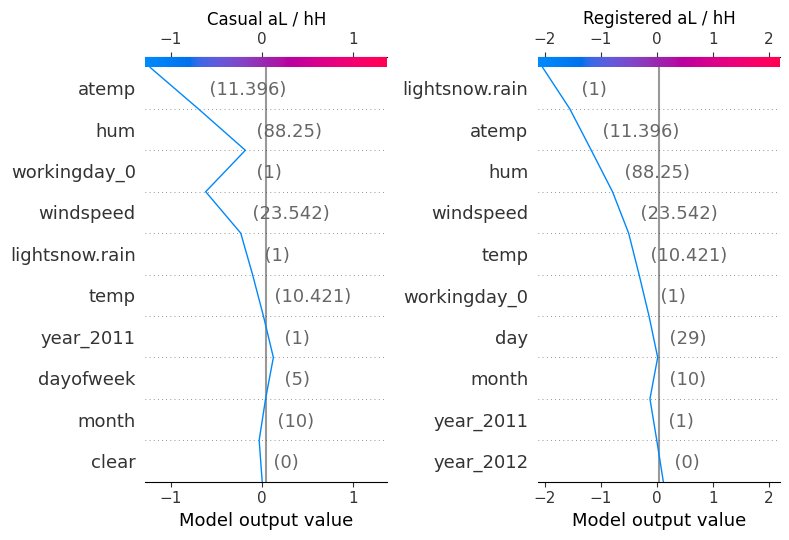

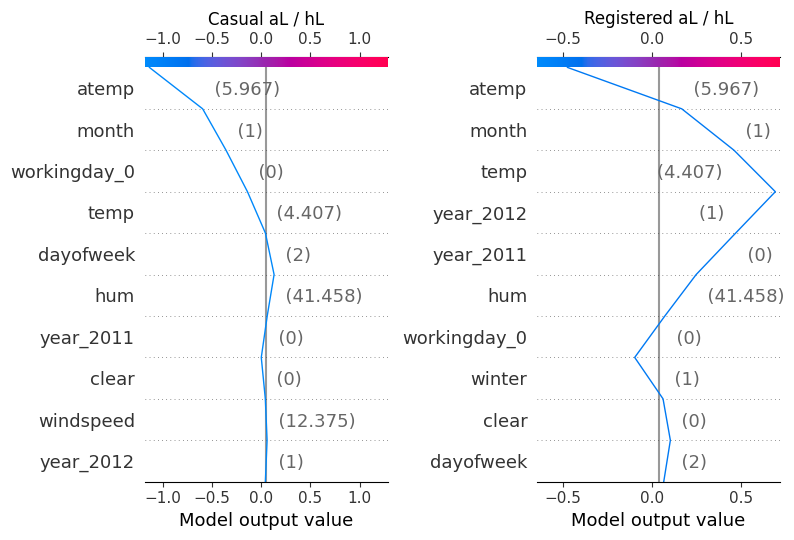

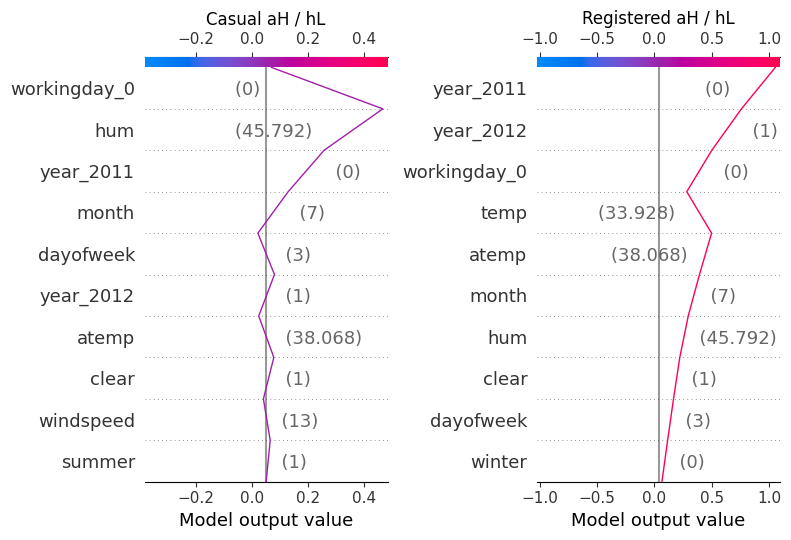

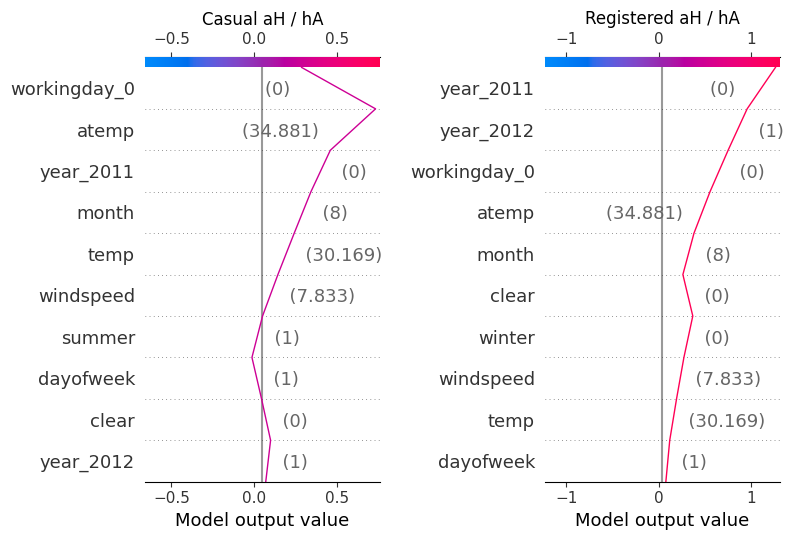

In [82]:
# activate javascript
shap.initjs()

# Causal
explainer_casual_shap = shap.TreeExplainer(xgbmodel_casual)

shap_values_casual_aL_hH = explainer_casual_shap.shap_values(aL_hH)
shap_values_casual_aL_hL = explainer_casual_shap.shap_values(aL_hL)
shap_values_casual_aH_hL = explainer_casual_shap.shap_values(aH_hL)
shap_values_casual_aH_hA = explainer_casual_shap.shap_values(aH_hA)

# Registered
explainer_registered_shap = shap.TreeExplainer(xgbmodel_registered)

shap_values_registered_aL_hH = explainer_registered_shap.shap_values(aL_hH)
shap_values_registered_aL_hL = explainer_registered_shap.shap_values(aL_hL)
shap_values_registered_aH_hL = explainer_registered_shap.shap_values(aH_hL)
shap_values_registered_aH_hA = explainer_registered_shap.shap_values(aH_hA)

plt.figure(figsize=(10, 10))

# Plot casual and registered
plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_aL_hH, aL_hH_origin,
                   feature_names=NAMES.values, show= False, feature_display_range=slice(None, -11, -1))
plt.title("Casual aL / hH")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_aL_hH, aL_hH_origin,
                   feature_names=NAMES.values, show= False, feature_display_range=slice(None, -11, -1))
plt.title("Registered aL / hH")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 10))

plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_aL_hL, aL_hL_origin,
                   feature_names=NAMES.values, show= False, feature_display_range=slice(None, -11, -1))
plt.title("Casual aL / hL")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_aL_hL, aL_hL_origin,
                   feature_names=NAMES.values, show= False, feature_display_range=slice(None, -11, -1))
plt.title("Registered aL / hL")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 10))

plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_aH_hL, aH_hL_origin,
                   feature_names=NAMES.values, show= False, feature_display_range=slice(None, -11, -1))
plt.title("Casual aH / hL")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_aH_hL, aH_hL_origin,
                   feature_names=NAMES.values, show= False, feature_display_range=slice(None, -11, -1))
plt.title("Registered aH / hL")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 10))

plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_aH_hA, aH_hA_origin,
                   feature_names=NAMES.values, show= False, feature_display_range=slice(None, -11, -1))
plt.title("Casual aH / hA")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_aH_hA, aH_hA_origin,
                   feature_names=NAMES.values, show= False, feature_display_range=slice(None, -11, -1))
plt.title("Registered aH / hA")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

***
***
***

<b> B-4. Find two day-instances for bike renting on a working day and weekend targeting a casual user and two other days for bike renting on a working day and weekend targeting a registered user. Note that the model for a casual user and a registered user is different since the targets are different. Given the four instances, show the four LIME visualizations. The four instances are categorized as ‘a working day/casual user’, ‘a working day/registered user’, ‘a weekend/casual user’, and ‘a weekend/registered user’.

- Casual

In [83]:
explanation_weekEnd_sample_casual = explainer_casual_lime.explain_instance(weekEnd_sample.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_weekEnd_sample_casual.show_in_notebook(show_all=False)

explanation_weekDay_sample_casual = explainer_casual_lime.explain_instance(weekDay_sample.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_weekDay_sample_casual.show_in_notebook(show_all=False)

Intercept -0.19270443130965426
Prediction_local [0.77211309]
Right: 0.08764781


Intercept 0.67272412828061
Prediction_local [0.08461319]
Right: -0.018831389


- Registered

In [84]:
explanation_weekEnd_sample_registered = explainer_registered_lime.explain_instance(weekEnd_sample.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_weekEnd_sample_registered.show_in_notebook(show_all=False)

explanation_weekDay_sample_registered = explainer_registered_lime.explain_instance(weekDay_sample.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aL_hL_registered.show_in_notebook(show_all=False)

Intercept 0.18501234081944623
Prediction_local [-0.97779276]
Right: -0.8336418


Intercept -0.8075842052733919
Prediction_local [0.18240125]
Right: 0.34804556


***
***
***

<b> B-5. Based on ‘B-4’, compare the results of ‘casual’ users and ‘registered’ users and describe the similarities and differences.

Based on the single instance LIME explanation in this example and your comparison analysis, if you are the CEO of this bike rental company, what is your marketing strategy based on the findings? 

***
***
***

<b> B-6. Based on ‘B-4’, use SHAP for local explanations and describe the similarities and differences.

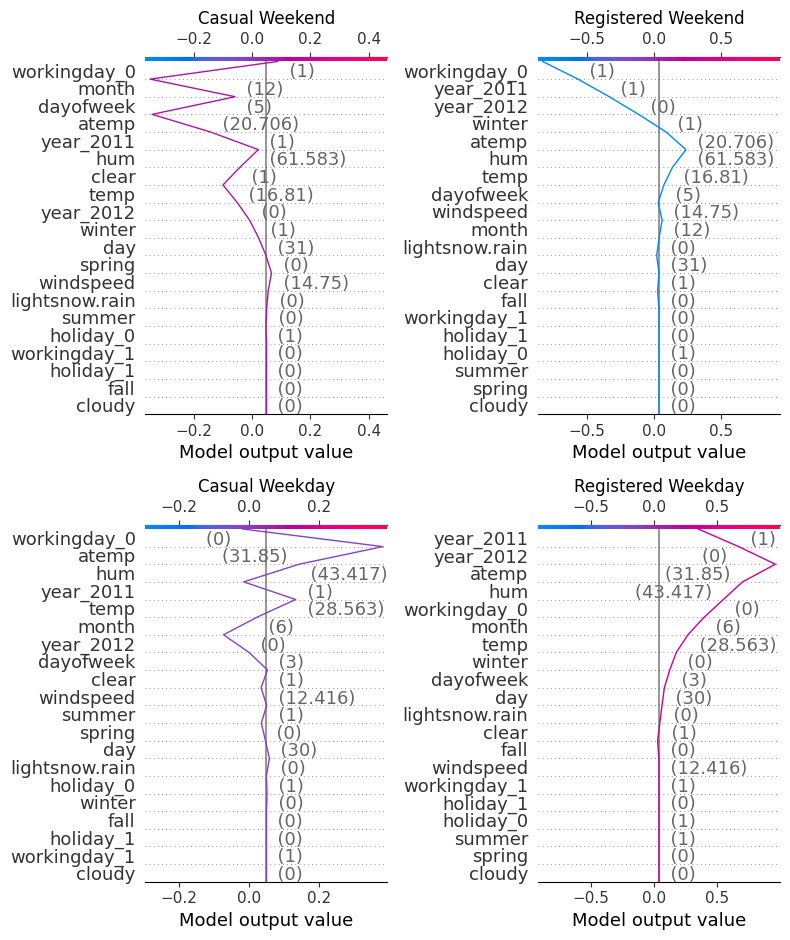

In [85]:
shap_values_casual_weekEnd_sample = explainer_casual_shap.shap_values(weekEnd_sample)
shap_values_casual_weekDay_sample = explainer_casual_shap.shap_values(weekDay_sample)

shap_values_registered_weekEnd_sample = explainer_registered_shap.shap_values(weekEnd_sample)
shap_values_registered_weekDay_sample = explainer_registered_shap.shap_values(weekDay_sample)

plt.figure(figsize=(10, 10))

# Plot casual and registered for the weekend on the first row
plt.subplot(2, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_weekEnd_sample, weekEnd_sample_origin, feature_names=NAMES.values, show=False)
plt.title("Casual Weekend")

plt.subplot(2, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_weekEnd_sample, weekEnd_sample_origin, feature_names=NAMES.values, show= False)
plt.title("Registered Weekend")

# Plot casual and registered for the weekday on the second row
plt.subplot(2, 2, 3)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_weekDay_sample, weekDay_sample_origin, feature_names=NAMES.values, show= False)
plt.title("Casual Weekday")

plt.subplot(2, 2, 4)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_weekDay_sample, weekDay_sample_origin, feature_names=NAMES.values, show= False)
plt.title("Registered Weekday")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()


***
***
***

<b> B-7. (Reflection) After analyzing and comparing the results of LIME and SHAP, what are the advantages of post-hoc explanation and LIME and SHAP, respectively?

***
***
***

<b> B-8. (Reflection) After analyzing and comparing the results of LIME and SHAP, what are the disadvantages of post-hoc explanation and LIME and SHAP, respectively?

***
***
***

<b> B-9. (Reflection) How much can you trust the results of LIME and SHAP? List the current limitations arising from post-hoc explanations (refer to the articles below and cite them).

***
***
***

<b> B-10. (Reflection) Considering the limitations described above, what and how can LIME and SHAP be refined to improve trustworthiness?